<center>
    <img src = "https://images2.imgbox.com/a5/72/7ZbDUHlf_o.jpg" width="250">
</center>

<br>


# Projeto Final - Técnicas de Programação II

O projeto teve como objetivo a aplicação prática do conteúdo de visualização de dados com Python, por meio de uma EDA (Exploratory Data Analysis), utilizando as bibliotecas:
- [Pandas](https://pandas.pydata.org/)
- [Seaborn](https://seaborn.pydata.org/)
- [Matplotlib](https://matplotlib.org/)
- [Plotly](https://plotly.com/)


<center>
    <img src = "https://images2.imgbox.com/fb/05/oWH0RtlR_o.gif" width="500">
</center>

<br>




## Base de Dados
O dataset selecionado para análise foi o [Music Label](https://www.kaggle.com/datasets/revilrosa/music-label-dataset), conjunto de dados de música gerado sinteticamente.



### Informações sobre as variáveis do dataset

### ARTISTS

`artist_id:` identificador exclusivo do artista;   
`real_name:` nome real do artista;  
`art_name:`  nome artístico;  
`role:` o papel principal do artista (cantor, guitarrista, dançarino, baterista etc.);  
`year_of_birth:` ano de nascimento do artista;  
`email:` o e-mail do artista;  
`country:` de onde vem o artista;  
`city:` a cidade em que o artista vive;  
`zip_code:` o CEP/zip code.  

### ALBUMS

`album_id:` o identificador do álbum;  
`artist_id:` o identificador do artista;  
`album_title:` o título do álbum;  
`genre:` o gênero do álbum;  
`year_of_pub:` o ano em que o álbum foi lançado;  
`num_of_tracks:` quantas faixas há no álbum;  
`num_of_sales:` quantas vendas o álbum fez no primeiro mês após o lançamento;  
`rolling_stone_critic:` como a revista Rolling Stone avaliou o álbum;  
`mtv_critic:`  como a MTV avaliou o álbum;  
`music_maniac_critic:` como o site de críticas Music Maniac avaliou o álbum. 

In [42]:
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

In [43]:
df_albums  = pd.read_csv('data/albums.csv', index_col=0)
df_artists = pd.read_csv('data/artists.csv', index_col=0)

### Informações sobre os datasets

In [3]:
print('O dataset albums possui {} variáveis e {} observações.'.format(df_albums.shape[1],df_albums.shape[0]))
print('O dataset artists possui {} variáveis e {} observações.'.format(df_artists.shape[1],df_artists.shape[0]))


O dataset albums possui 9 variáveis e 100000 observações.
O dataset artists possui 8 variáveis e 50000 observações.


### Primeiras 5 observações do dataset `albums` e 5 últimas

In [4]:
df_albums.head()


,artist_id,album_title,genre,year_of_pub,num_of_tracks,num_of_sales,rolling_stone_critic,mtv_critic,music_maniac_critic
album_id,,,,,,,,,
1,1767,Call me Cat Moneyless That Doggies,Folk,2006,11,905193,4.0,1.5,3.0
2,23548,Down Mare,Metal,2014,7,969122,3.0,4.0,5.0
3,17822,Embarrassed Hungry,Latino,2000,11,522095,2.5,1.0,2.0
4,19565,Standard Immediate Engineer Slovakia,Pop,2017,4,610116,1.5,2.0,4.0
5,24941,Decent Distance Georgian,Black Metal,2010,8,151111,4.5,2.5,1.0


In [5]:
df_albums.tail()


,artist_id,album_title,genre,year_of_pub,num_of_tracks,num_of_sales,rolling_stone_critic,mtv_critic,music_maniac_critic
album_id,,,,,,,,,
99996,44624,Mike Pies Malay Albanian Terrible,Pop-Rock,2016,3,871655,2.5,1.5,1.0
99997,16345,Global,Retro,2013,14,146202,5.0,2.5,1.0
99998,32674,MINI,Indie,2018,4,620452,2.0,4.0,5.0
99999,10134,Marketing Belligerent Toe,Pop,2007,7,643276,4.0,1.5,4.0
100000,41286,Lover Barbie Of Rock,Rock,2014,7,466962,3.5,4.5,2.5


### Primeiras 5 observações do dataset `artists` e 5 últimas

In [6]:
df_artists.head()


,real_name,art_name,role,year_of_birth,country,city,email,zip_code
artist_id,,,,,,,,
1,Kameko Nelson,NaN,female voice,1981,Slovenia,Vedrin,lorem.tristique.aliquet@nonummyFusce.co.uk,6914
2,Sacha Cameron,Bianco Ibureno Chloride,artist,1955,Guernsey,Montigny-le-Tilleul,Sed@elementum.com,568
3,Thane E. Oliver,NaN,rapper,1993,Guinea-Bissau,Saint-Sébastien-sur-Loire,Integer.tincidunt.aliquam@libero.com,813154
4,Cole E. Joseph,Persian responsible,bassist,1994,Estonia,Newquay,nulla.magna.malesuada@vulputate.com,A4S 2B3
5,Sonia U. Jensen,Asleep lonely Big Morgan,DJ,1988,Vanuatu,Dudzele,faucibus@euismodetcommodo.edu,46418


In [7]:
df_artists.tail()


,real_name,art_name,role,year_of_birth,country,city,email,zip_code
artist_id,,,,,,,,
49996,Cain G. Estes,Pakistan,band member,1982,Aruba,Cagli,In@tinciduntduiaugue.co.uk,YW2 0LG
49997,Unity D. Valenzuela,Bislama Brass,drummer,1956,Canada,Caprino Bergamasco,Donec.porttitor.tellus@augueporttitorinterdum.org,6999 YX
49998,Lamar Porter,Typical,rapper,1990,Bangladesh,Massarosa,consectetuer.adipiscing@In.com,34-682
49999,Sylvester O. Mccall,Glossy Kyleigh,chorister,1994,Libya,Tramutola,mi@laoreet.edu,8737
50000,Rashad Z. Medina,NaN,rapper,1958,Saint Barthélemy,Faridabad,eu@morbi.ca,8129


### Juntando os datasets

Pelos dados, um artista possui mais de um álbum, mas um álbum pertence a apenas um artista.

In [8]:
df_music = pd.merge(df_albums, df_artists, on='artist_id', how='left')
df_music


,artist_id,album_title,genre,year_of_pub,num_of_tracks,num_of_sales,rolling_stone_critic,mtv_critic,music_maniac_critic,real_name,art_name,role,year_of_birth,country,city,email,zip_code
0,1767,Call me Cat Moneyless That Doggies,Folk,2006,11,905193,4.0,1.5,3.0,Duncan Y. Nieves,NaN,composer,2000,Myanmar,Lincoln,sed@Inat.org,52324
1,23548,Down Mare,Metal,2014,7,969122,3.0,4.0,5.0,Oleg X. Koch,Messy Harold Herald,trapper,1966,Oman,Newport,fames.ac.turpis@felis.com,11703
2,17822,Embarrassed Hungry,Latino,2000,11,522095,2.5,1.0,2.0,Hedwig D. Schwartz,Tots-Courageous Fitness Trainer,guitarist,1958,United Kingdom (Great Britain),Bayonne,posuere.cubilia.Curae@necurnasuscipit.edu,24297
3,19565,Standard Immediate Engineer Slovakia,Pop,2017,4,610116,1.5,2.0,4.0,Chaim B. Whitfield,Skye Matter,soprano,1988,Virgin Islands British,Kermt,iaculis.lacus@Donecnon.org,5852 NA
4,24941,Decent Distance Georgian,Black Metal,2010,8,151111,4.5,2.5,1.0,Lawrence Atkins,Confident Aono search,drummer,1995,Gambia,Sherborne,dis.parturient@musAenean.co.uk,4308
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,44624,Mike Pies Malay Albanian Terrible,Pop-Rock,2016,3,871655,2.5,1.5,1.0,Lucian T. Bruce,Jordan,soprano,1965,Chad,Castro,parturient.montes@lobortisClassaptent.com,0750 TE
99996,16345,Global,Retro,2013,14,146202,5.0,2.5,1.0,Kylie Mclaughlin,Francisco,guitarist,1998,Bouvet Island,Palagano,Aliquam.fringilla@inconsectetuer.co.uk,333322
99997,32674,MINI,Indie,2018,4,620452,2.0,4.0,5.0,Odette Logan,NaN,artist,1996,Pitcairn Islands,Gulfport,mauris@Seddiam.co.uk,109875
99998,10134,Marketing Belligerent Toe,Pop,2007,7,643276,4.0,1.5,4.0,Baker Y. Moore,Kendall,guitarist,1983,Guadeloupe,Pazarcık,feugiat.metus@enimnectempus.net,114458


### Informações sobre as variáveis do dataset 

In [9]:
df_music.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 100000 entries, 0 to 99999
Data columns (total 17 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   artist_id             100000 non-null  int64  
 1   album_title           100000 non-null  object 
 2   genre                 100000 non-null  object 
 3   year_of_pub           100000 non-null  int64  
 4   num_of_tracks         100000 non-null  int64  
 5   num_of_sales          100000 non-null  int64  
 6   rolling_stone_critic  100000 non-null  float64
 7   mtv_critic            100000 non-null  float64
 8   music_maniac_critic   100000 non-null  float64
 9   real_name             100000 non-null  object 
 10  art_name              66488 non-null   object 
 11  role                  100000 non-null  object 
 12  year_of_birth         100000 non-null  int64  
 13  country               100000 non-null  object 
 14  city                  100000 non-null  object 
 15  e

### Percentual de dados faltantes

Como apenas a variável do nome artístico possui um alto valor de dados nulos, e considerando que nem todos os artistas possuem um, também não sendo uma variável relevante para as análises, optou-se por não executar nenhum tratamento quanto a isso. 

In [11]:
df_music.isnull().mean().round(4)*100


artist_id                0.00
album_title              0.00
genre                    0.00
year_of_pub              0.00
num_of_tracks            0.00
num_of_sales             0.00
rolling_stone_critic     0.00
mtv_critic               0.00
music_maniac_critic      0.00
real_name                0.00
art_name                33.51
role                     0.00
year_of_birth            0.00
country                  0.00
city                     0.00
email                    0.00
zip_code                 0.00
dtype: float64

### Medidas resumo das variáveis quantitativas

Apesar das variações das medidas de tendência central, fazendo com que essas variáveis quantitativas não tenham uma distribuição normal, os dados não possuem outliers.

In [10]:
df_music.drop(columns=['artist_id','year_of_birth','year_of_pub']).describe(percentiles = [.25, .5, .75, .95, .99]).round(2)


,num_of_tracks,num_of_sales,rolling_stone_critic,mtv_critic,music_maniac_critic
count,100000.00,100000.00,100000.00,100000.00,100000.00
mean,8.49,500044.73,2.75,2.75,2.75
std,4.05,288033.73,1.44,1.44,1.43
min,2.00,1009.00,0.50,0.50,0.50
25%,5.00,251603.50,1.50,1.50,1.50
50%,8.00,499531.50,2.50,3.00,3.00
75%,12.00,749354.25,4.00,4.00,4.00
95%,15.00,949499.85,5.00,5.00,5.00
99%,15.00,990141.11,5.00,5.00,5.00
max,15.00,999994.00,5.00,5.00,5.00


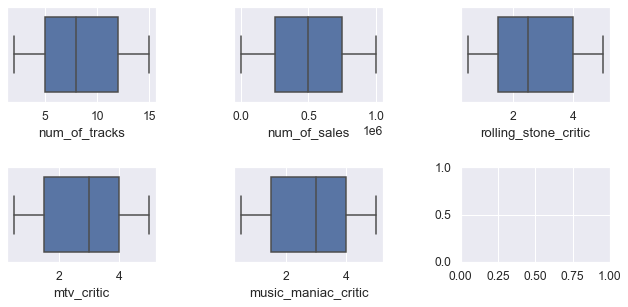

In [132]:
# Boxplot das variáveis quantitativas 
fig, ax = plt.subplots(2, 3, figsize=(10,5))

fig.tight_layout(pad=3)
sns.boxplot(data=df_music, x='num_of_tracks', ax=ax[0,0])
sns.boxplot(data=df_music, x='num_of_sales', ax=ax[0,1])
sns.boxplot(data=df_music, x='rolling_stone_critic', ax=ax[0,2])
sns.boxplot(data=df_music, x='mtv_critic', ax=ax[1,0])
sns.boxplot(data=df_music, x='music_maniac_critic', ax=ax[1,1]);


### Distribuição bivariada

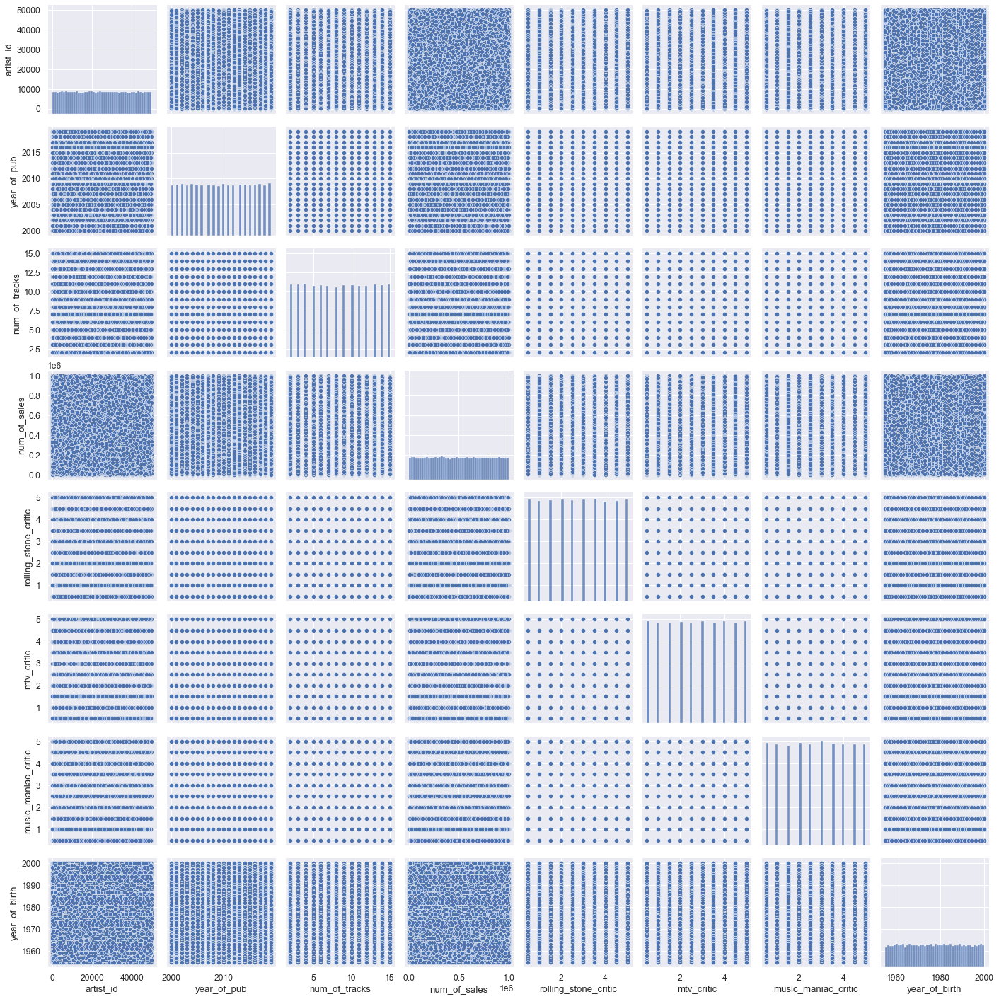

In [104]:
sns.pairplot(data=df_music);


<center>
    <img src = "https://images2.imgbox.com/ff/39/pAJNxfUn_o.gif" width="500">
</center>

<br>
<br>
<br>
    
<center>
    <font color=black size=10><b> Análise Exploratória dos Dados </b></font>
</center> 

### A análise exploratória dos dados respondeu as seguintes perguntas:

- Quais os 10 gêneros com mais álbuns no dataset?
- Qual a quantidade de vendas por ano dos 10 gêneros com mais álbums?
- Quais são as funções com maior quantidade de artistas do dataset?
- Quais os 5 artistas com maior quantidade de álbuns?
- Quais os nomes mais comuns em álbuns e qual a média de faixas entre eles?
- Qual a distribuição de avaliações dos álbuns pela Music Maniac, MTV e Rolling Stones?
- Existe alguma correlação entre a quantidade de álbuns vendidos e a avalição recebida por eles?
- Qual a quantidade de vendas de álbuns de todos os gêneros no Brasil por ano?
- Existe alguma correlação entre as variáveis do dataset do Brasil?
- Quais os 10 gêneros com mais álbuns no Brasil e sua distribuição do número de vendas?
- Qual a distribuição de avaliações dos álbuns pela Music Maniac, MTV e Rolling Stones no Brasil?

### Quais os 10 gêneros com mais álbuns no dataset?
- Pandas e Matplotlib

Os álbuns dos gêneros Indie, Pop e Rap apresentam a maior quantidade de álbuns no dataset e uma diferença significativa entre os demais.

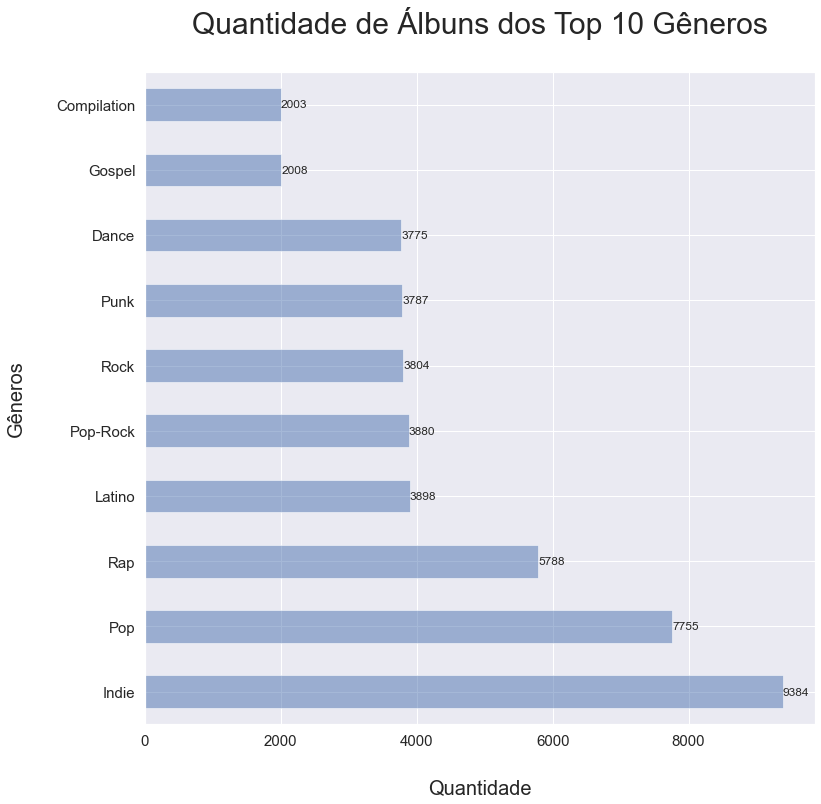

In [51]:
ax = df_music['genre'].value_counts(ascending=True).sort_values(ascending=False).head(10).plot(kind='barh', 
                                                                                              alpha=0.5,
                                                                                              fontsize=15,
                                                                                              figsize=(12,12))
ax.bar_label(ax.containers[0], fontsize=12)
ax.set_ylabel('Gêneros', fontsize=20, labelpad=30)
ax.set_xlabel('Quantidade', fontsize=20, labelpad=30)
ax.set_title('Quantidade de Álbuns dos Top 10 Gêneros', y=1.05, fontsize=30);


### Qual a quantidade de vendas por ano dos 10 gêneros com mais álbums?
- Pandas e Matplotlib

Gêneros com mais álbuns, como visto anteriormente, também são os mais vendidos, destacando-se Indie, Pop, Rap.

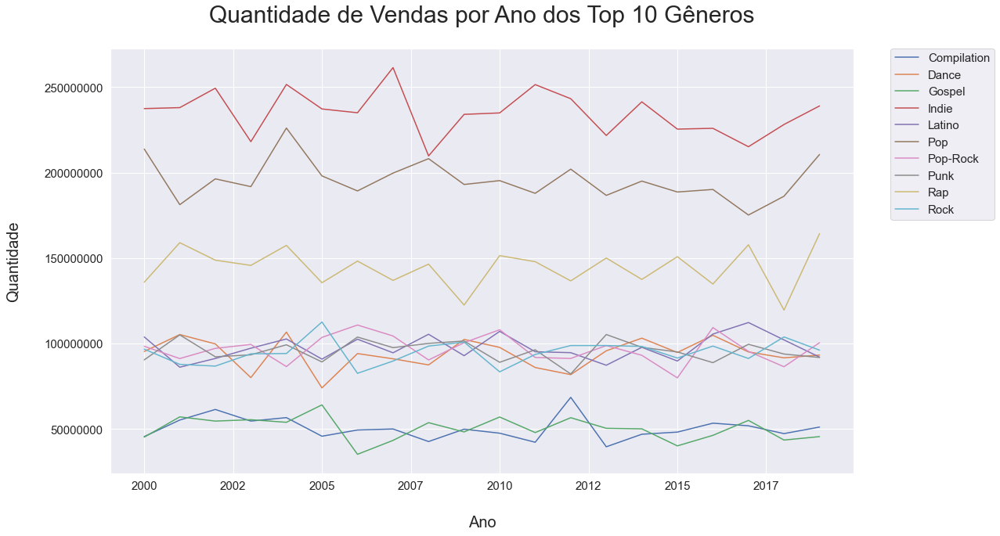

In [60]:
from matplotlib.ticker import FormatStrFormatter

top_genres = df_music.groupby('genre')['genre'].count().sort_values(ascending=False).head(10).index.to_list()

ax = df_music.query('genre in @top_genres').pivot_table(index='year_of_pub', 
                                                        columns='genre', 
                                                        values='num_of_sales', 
                                                        aggfunc='sum').plot(kind="line", 
                                                                            fontsize=15,
                                                                            figsize=(17, 10))

ax.set_xlabel('Ano', fontsize=20, labelpad=30)
ax.ticklabel_format(useOffset=False, style='plain')
ax.set_ylabel('Quantidade', fontsize=20, labelpad=30)
ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
ax.set_title('Quantidade de Vendas por Ano dos Top 10 Gêneros', y=1.05, fontsize=30)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=15);


### Quais são as funções com maior quantidade de artistas do dataset?
- Matplotlib e Seaborn

É possível perceber que o dataset possui mais artistas que são compositores, trappers, guitarristas, sopranos e bateristas.

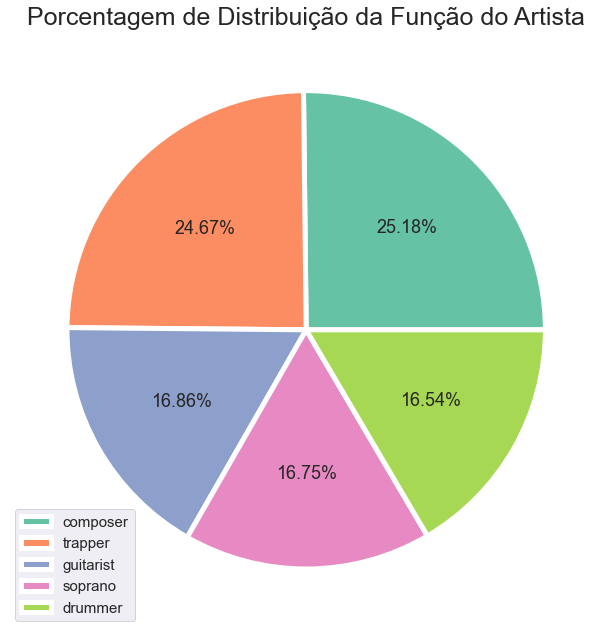

In [66]:
colors = sns.color_palette('Set2')
fig, ax = plt.subplots(figsize=(18,11))

ax.pie('Quantidade', 
       data=df_music['role'].value_counts().head(5).to_frame("Quantidade"), 
       autopct='%1.2f%%', 
       wedgeprops = {'linewidth':5, 'edgecolor':'white'},
       textprops = {'fontsize':18},
       colors=colors)

plt.legend(df_music['role'], loc="lower left", fontsize=15)
ax.set_title('Porcentagem de Distribuição da Função do Artista', fontsize=25);


### Quais os 5 artistas com maior quantidade de álbuns?
- Pandas e Matplotlib

A quantidade de álbuns varia entre 1 e 11 entre artistas, todos possuindo ao menos um álbum, sendo Mallory W. Sheppard a única pessoa do dataset com 11 álbuns.

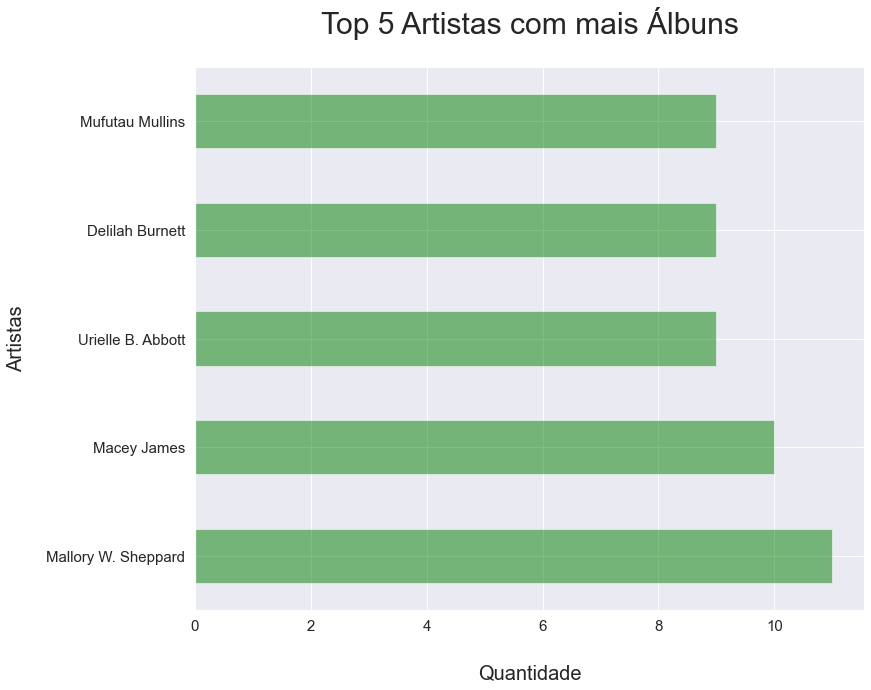

In [114]:
artists = df_music.groupby('real_name')['real_name'].count().sort_values(ascending=False).head(5)

ax = artists.plot(kind ='barh', color='green', alpha=0.5, figsize=(12,10), fontsize=15);

ax.set_ylabel('Artistas', fontsize=20, labelpad=20)
ax.set_xlabel('Quantidade', fontsize=20, labelpad=30)
ax.set_title('Top 5 Artistas com mais Álbuns', y=1.05, fontsize=30);


### Quais os nomes mais comuns em álbuns e qual a média de faixas entre eles?
- Plotly

Apesar de vários álbuns possuírem mesmo nome, os mesmos pertencem a artistas, anos e número de faixas diferentes. 
Of love é o título mais popular pertencendo a 211 álbuns e possuindo em média 8 faixas.

In [16]:
albums = df_music.groupby(['album_title']).agg(qtd_albuns=('album_title','count'),
                                               avg_faixas=('num_of_tracks','mean')).reset_index().sort_values('qtd_albuns',
                                                                                                    ascending=False).head(4)
fig = px.bar(albums, 
             x='album_title', 
             y=['qtd_albuns','avg_faixas'], 
             barmode='group',
             width=900, 
             height=600,
             title='Top 4 Nomes de Álbuns e Quantidade Média de Faixas')

fig.update_layout(
    xaxis_title="Nome dos Álbuns",
    yaxis_title="Quantidade",
    legend_title="Legenda",
    template='none',
    font=dict(  
        size=17
    )
)


### Qual a distribuição de avaliações dos álbuns pela Music Maniac, MTV e Rolling Stones?
- Plotly

In [17]:
fig = px.box(data_frame=df_music, 
             x=['music_maniac_critic','mtv_critic','rolling_stone_critic'],
             width=800, 
             height=800,
             title='Distribuição de Avaliações')

fig.update_layout(
    xaxis_title='Nota',
    yaxis_title='Avaliador',
    font=dict(  
        size=17
    )
)
fig.update_yaxes(
    ticktext=['Music Maniac','MTV','Rolling Stones'],
    tickvals=[0, 1, 2]
)


### Existe alguma correlação entre a quantidade de álbuns vendidos e a avalição recebida por eles?
- Seaborn e Matplotlib

Os dados não apresentaram nenhuma correlação relevante para a análise.

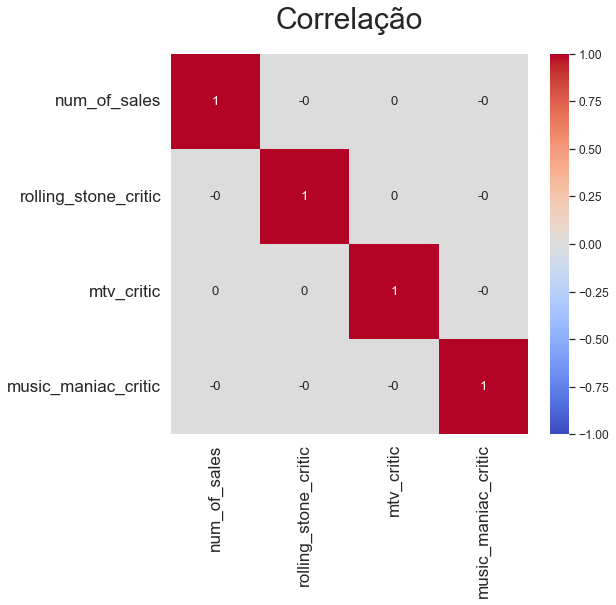

In [131]:
df = df_music.iloc[:,5:9]

sns.set(font_scale=1.1)
plt.figure(figsize = (8,7))
sns.heatmap(df.corr().round(2), annot=True, vmin=-1, vmax=1, cmap='coolwarm')

plt.title('Correlação', fontsize=30, y=1.05)
plt.xticks(fontsize=17, rotation=90)
plt.yticks(fontsize=17, rotation=360);



<center>
    <font color=green size=15><b> Análise dos Dados do Brasil </b></font>
</center> 


### Existe alguma correlação entre as variáveis do dataset do Brasil?
- Seaborn e Matplotlib

Os dados não apresentaram nenhuma correlação relevante para a análise.

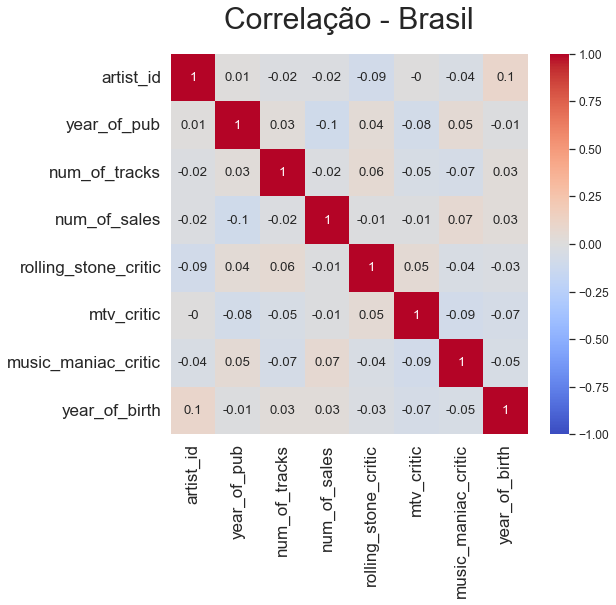

In [116]:
brazil = df_music.loc[df_music.country == 'Brazil']
sns.set(font_scale=1.1)
plt.figure(figsize = (8,7))
sns.heatmap(brazil.corr().round(2), annot=True, vmin=-1, vmax=1, cmap='coolwarm')

plt.title('Correlação - Brasil', fontsize=30, y=1.05)
plt.xticks(fontsize=17, rotation=90)
plt.yticks(fontsize=17);


### Qual a quantidade de vendas de álbuns de todos os gêneros no Brasil por ano?
- Plotly

In [19]:
fig = px.scatter(brazil, 
                 x='year_of_pub', 
                 y='num_of_sales', 
                 color='genre',
                 size='num_of_sales',
                 width=1000, 
                 height=600,
                 title='Quantidade de Vendas de Álbuns no Brasil por Ano')

fig.update_layout(
    xaxis_title="Ano",
    yaxis_title="Quantidade",
    legend_title="Legenda",
    template='none',
    font=dict(  
        size=17
    )
)


### Quais os 10 gêneros com mais álbuns no Brasil e sua distribuição do número de vendas?
- Seaborn e Matplotlib

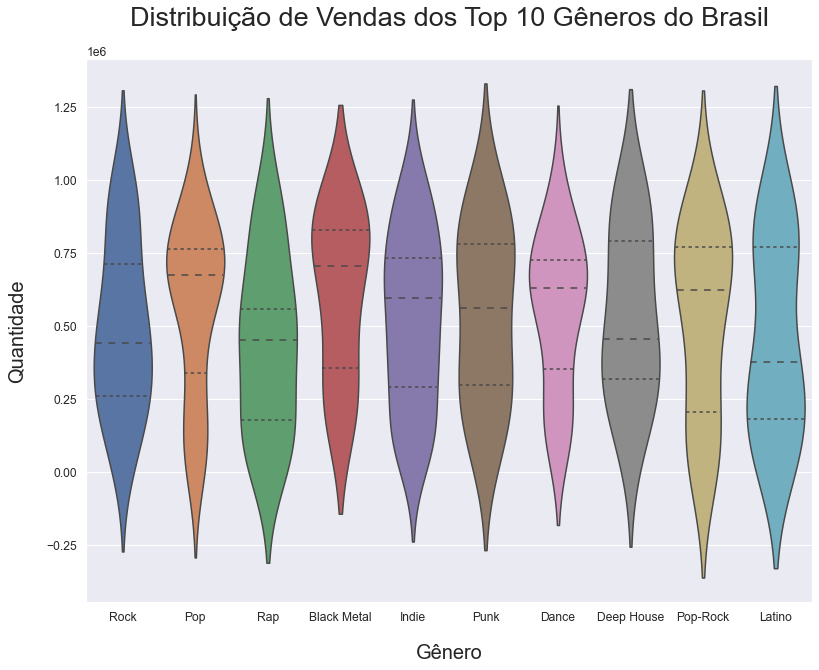

In [20]:
lst_genres = brazil.genre.value_counts().head(10).index.tolist()
genreb = brazil[brazil.genre.isin(lst_genres)]

plt.figure(figsize=(13,10))
sns.violinplot(x='genre', y='num_of_sales', data=genreb, scale='width', inner='quartile');

plt.xlabel('Gênero', fontsize=20, labelpad=20)
plt.ylabel('Quantidade', fontsize=20, labelpad=20)
plt.title('Distribuição de Vendas dos Top 10 Gêneros do Brasil', y=1.05, fontsize=27);


### Qual a distribuição de avaliações dos álbuns pela Music Maniac, MTV e Rolling Stones no Brasil?
- Plotly

In [22]:
# Em comparação a distribuição de avaliações do dataset, os dados do Brasil menor 
# mediana com o Music Maniac e não Rolling Stones 
fig = px.box(data_frame=brazil, 
             y=['music_maniac_critic','mtv_critic','rolling_stone_critic'],
             width=800, 
             height=600,
             title='Distribuição de Avaliações no Brasil')

fig.update_layout(
    xaxis_title='Avaliador',
    yaxis_title='Nota',
    font=dict(  
        size=17
    )
)
fig.update_xaxes(
    ticktext=['Music Maniac','MTV','Rolling Stones'],
    tickvals=[0, 1, 2]
)
